In [ ]:
from drone_detector.imports import *
from drone_detector.engines.detectron2.tta import *
from detectron2.engine import DefaultPredictor
from detectron2.config import get_cfg
from detectron2.utils.visualizer import Visualizer
from detectron2.data.datasets import register_coco_instances
from detectron2.data import build_detection_test_loader, DatasetCatalog, MetadataCatalog
from detectron2.evaluation  import COCOEvaluator, DatasetEvaluators, inference_on_dataset
import cv2
import matplotlib.pyplot as plt
import torch

First, see the results for patch level data. Patch level data means 512x512 pixel image patches, while virtual plot level data means larger scenes.

# Validation set results

Read validation set and register it to detectron2.

In [ ]:
datapath = Path('../../data/processed/hiidenportti/')
register_coco_instances('hiidenportti_val', {}, datapath/'hiidenportti_valid.json', datapath/'valid_512')

Read model config and create predictor.

In [ ]:
cfg = get_cfg()
cfg.merge_from_file('../models/hiidenportti/mask_rcnn_R_101_FPN_3x/config.yaml')
cfg.DEVICE = f'cuda:{torch.cuda.current_device()}'
cfg.OUTPUT_DIR = '../models/hiidenportti/mask_rcnn_R_101_FPN_3x/'
cfg.MODEL.WEIGHTS = os.path.join(cfg.OUTPUT_DIR, 'model_final.pth')
cfg.MODEL.ROI_HEADS.SCORE_THRESH_TEST = 0.5
predictor = DefaultPredictor(cfg)

Run COCO evaluations without Test-Time Augmentation.

In [ ]:
evaluator = COCOEvaluator('hiidenportti_val', output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, 'hiidenportti_val')
print(inference_on_dataset(predictor.model, val_loader, evaluator))

/opt/conda/lib/python3.9/site-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/opt/conda/lib/python3.9/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.294
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.561
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.276
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.189
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.217
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.416
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.423
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.381
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.357
 Average Recall     (AR) @[ IoU=0.50:0

View example predictions and compare them to annotations.

/opt/conda/lib/python3.9/site-packages/detectron2/structures/image_list.py:88: UserWarning: __floordiv__ is deprecated, and its behavior will change in a future version of pytorch. It currently rounds toward 0 (like the 'trunc' function NOT 'floor'). This results in incorrect rounding for negative values. To keep the current behavior, use torch.div(a, b, rounding_mode='trunc'), or for actual floor division, use torch.div(a, b, rounding_mode='floor').
  max_size = (max_size + (stride - 1)) // stride * stride
/opt/conda/lib/python3.9/site-packages/torch/functional.py:445: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2157.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


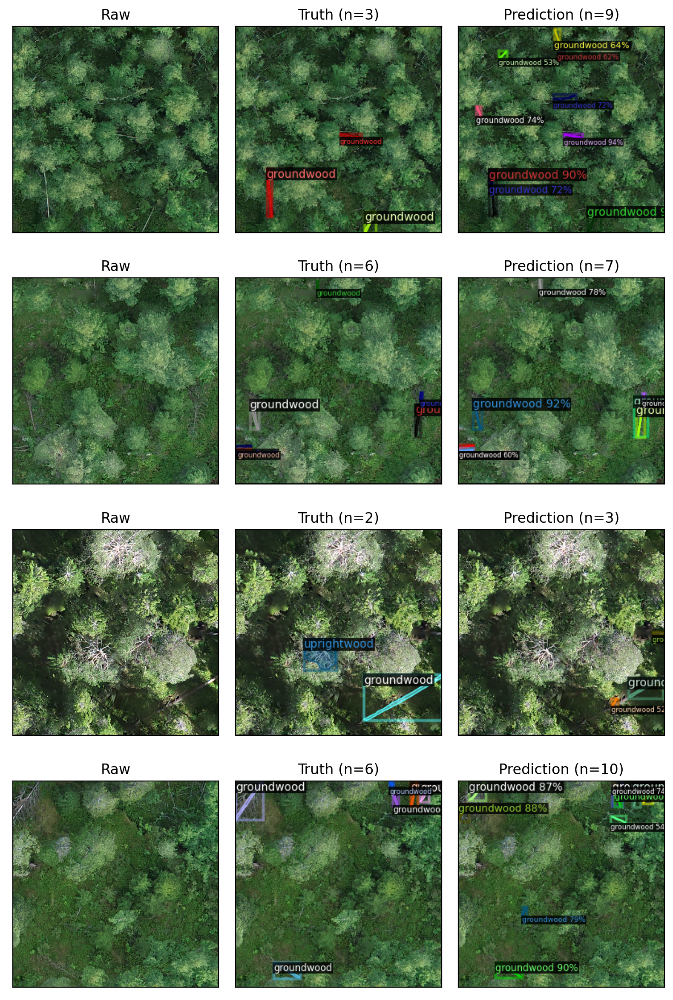

In [ ]:
#| echo: false

dataset_dicts = DatasetCatalog.get('hiidenportti_val')
fig, axs = plt.subplots(4,3, dpi=200, figsize=(8,12))
ddicts = random.sample(dataset_dicts, 4)
for d, i in zip(ddicts, range(0,4)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_val'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_val'), scale=.5)
    preds = predictor(img)
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()

See the effect of TTA. Augmentations used are horizontal and vertical flips and running predictions to different image sizes.

In [ ]:
cfg.TEST.AUG.MIN_SIZES = (cfg.INPUT.MIN_SIZE_TEST-200, cfg.INPUT.MIN_SIZE_TEST, cfg.INPUT.MIN_SIZE_TEST+200,)
tta_predictor = TTAPredictor(cfg)

In [ ]:
evaluator = COCOEvaluator('hiidenportti_val', output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, 'hiidenportti_val')
print(inference_on_dataset(tta_predictor.model, val_loader, evaluator))

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.309
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.620
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.269
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.282
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.230
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.214
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.452
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.470
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.404
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.453
 Average Recall     (AR) @[ IoU=0.50:0

TTA increases AP50 score by 0.04 but is drastically slower to run.

Compare predictions with same patches as previously.

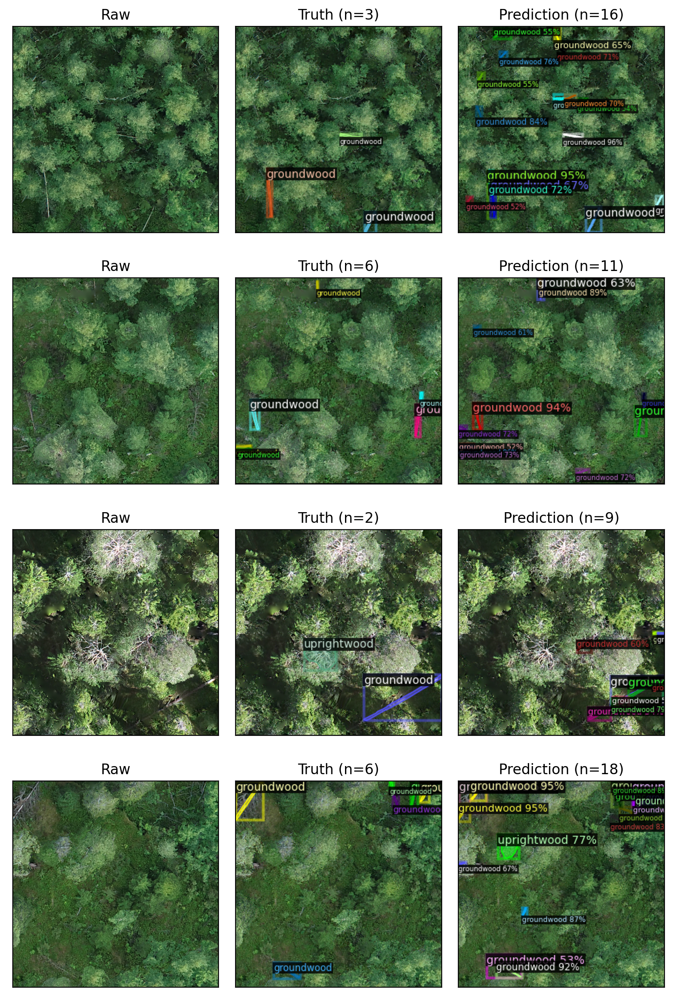

In [ ]:
#| echo: false

fig, axs = plt.subplots(4,3, dpi=200, figsize=(8,12))
for d, i in zip(ddicts, range(0,4)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_val'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_val'), scale=.5)
    preds = tta_predictor(img)
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()

# Test set results

Test set for Hiidenportti contains 5 virtual plots.

## Image patches

In [ ]:
register_coco_instances('hiidenportti_test', {}, datapath/'hiidenportti_test.json', datapath/'test_512')

In [ ]:
evaluator = COCOEvaluator('hiidenportti_test', output_dir=cfg.OUTPUT_DIR)
val_loader = build_detection_test_loader(cfg, "hiidenportti_test")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.332
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.621
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.319
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.243
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.173
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.418
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.437
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.369
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.426
 Average Recall     (AR) @[ IoU=0.50:0

Test set results are slightly better than validation set results.

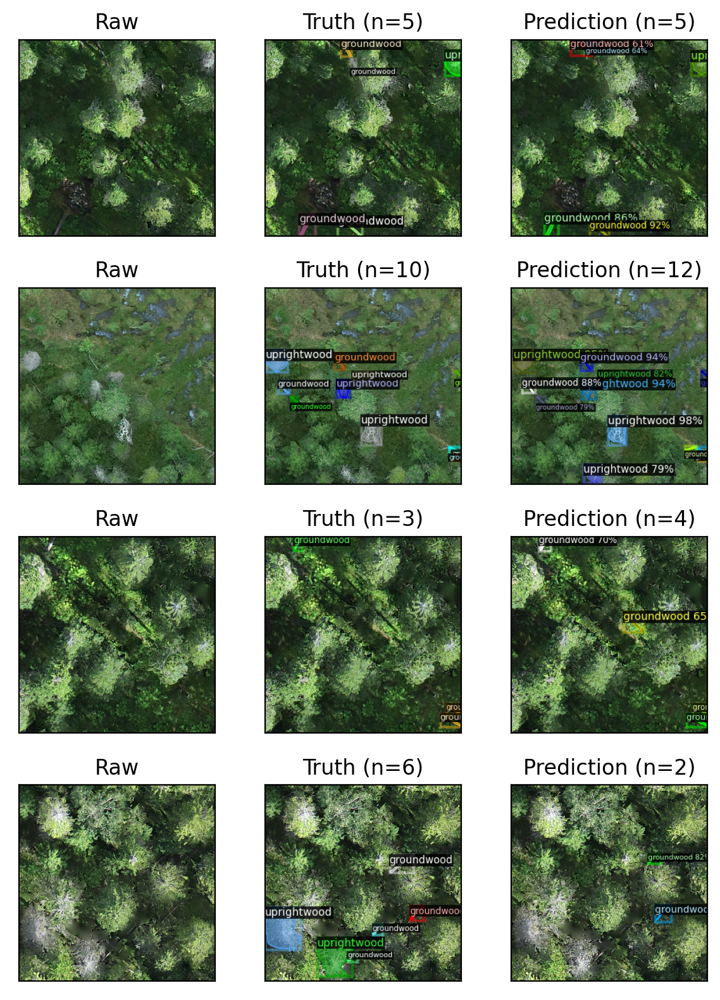

In [ ]:
#| echo: false

dataset_dicts = DatasetCatalog.get('hiidenportti_test')
fig, axs = plt.subplots(4,3, dpi=200, figsize=(6,8))
ddicts = random.sample(dataset_dicts, 4)
for d, i in zip(ddicts, range(0,4)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_test'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_test'), scale=.5)
    preds = predictor(img)
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()
plt.show()

Then check the effect of TTA for this set.

In [ ]:
evaluator = COCOEvaluator("hiidenportti_test", output_dir=cfg.OUTPUT_DIR, max_dets_per_image=100, use_fast_impl=False)
print(inference_on_dataset(tta_predictor.model, val_loader, evaluator))

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=0.57s).
Accumulating evaluation results...
DONE (t=0.06s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.359
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.674
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.345
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.353
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.272
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = -1.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.180
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.456
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.491
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1

Again, AP50-score increases when running TTA.

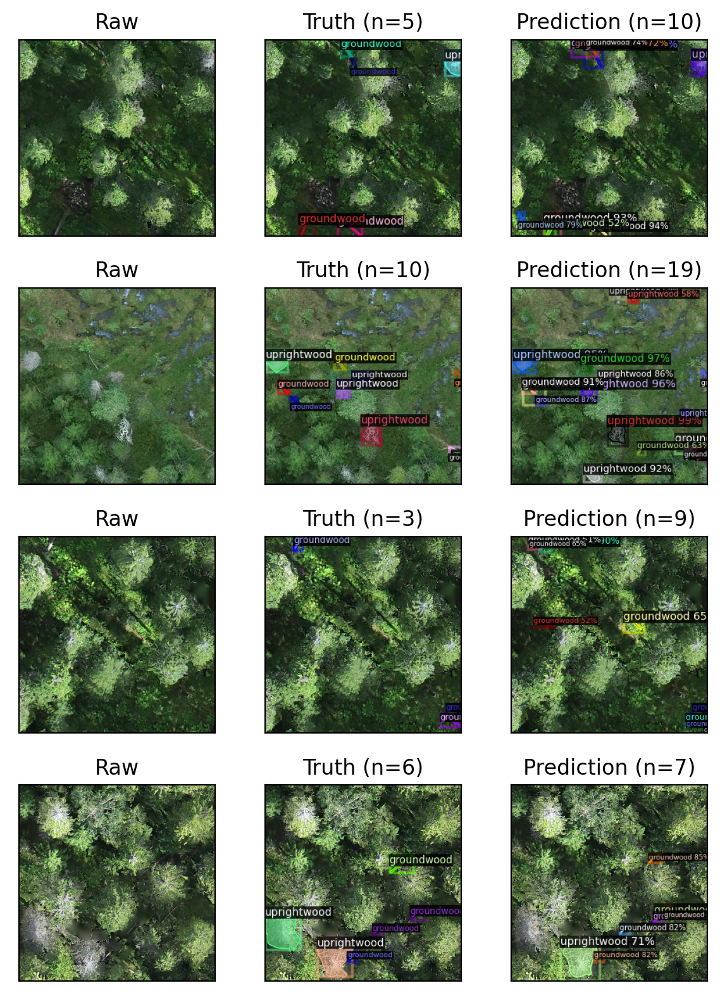

In [ ]:
#| echo: false

fig, axs = plt.subplots(4,3, dpi=200, figsize=(6,8))
for d, i in zip(ddicts, range(0,4)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_test'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('hiidenportti_test'), scale=.5)
    preds = tta_predictor(img)
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()
plt.show()

# Evo dataset

Evo dataset contains 71 100x100m virtual plots that have not been used to train the models.

In [ ]:
#| echo: false

# Combine several coco-annotation .json files into one

import json

full_coco = None
image_id_modifier = 0
ann_id_modifier = 0
spk_path = Path('../../data/processed/sudenpesankangas/')
files = ['sudenpesankangas_test.json', 'sudenpesankangas_train.json', 'sudenpesankangas_valid.json']
folders = ['test_512', 'train_512', 'valid_512']
for p, fol in zip(files, folders):
    with open(spk_path/p) as f:
        coco = json.load(f)
    
    # update filename
    for i in coco['images']:
        i['file_name'] = f"{fol}/{i['file_name']}"
        
    if full_coco is None: 
        full_coco = coco
        image_id_modifier = full_coco['images'][-1]['id']
        ann_id_modifier = full_coco['annotations'][-1]['id']
    else:
        for i in coco['images']:
            i['id'] += image_id_modifier
        for a in coco['annotations']:
            a['image_id'] += image_id_modifier
            a['id'] += ann_id_modifier
        
        full_coco['images'].extend(coco['images'])
        full_coco['annotations'].extend(coco['annotations'])
        image_id_modifier = full_coco['images'][-1]['id'] + 1
        ann_id_modifier = full_coco['annotations'][-1]['id'] + 1
        
with open(spk_path/'sudenpesankangas_all.json', 'w') as outfile: json.dump(full_coco, outfile)

Read full dataset and run the models without TTA.

In [ ]:
datapath = Path('../../data/processed/sudenpesankangas/')
register_coco_instances('sudenpesankangas_all', {}, datapath/'sudenpesankangas_all.json', datapath)

In [ ]:
from detectron2.evaluation import COCOEvaluator, inference_on_dataset
from detectron2.data import build_detection_test_loader
evaluator = COCOEvaluator("sudenpesankangas_all", output_dir=cfg.OUTPUT_DIR, max_dets_per_image=100, use_fast_impl=True)
val_loader = build_detection_test_loader(cfg, "sudenpesankangas_all")
print(inference_on_dataset(predictor.model, val_loader, evaluator))

Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.253
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.440
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.272
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.198
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.260
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.292
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.122
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.297
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.320
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.227
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.445
 Average Recall     (AR) @[ IoU=0.50:0.

The results are clearly worse than in Hiidenportti, as even the AP50-score is around 0.2 points lower.

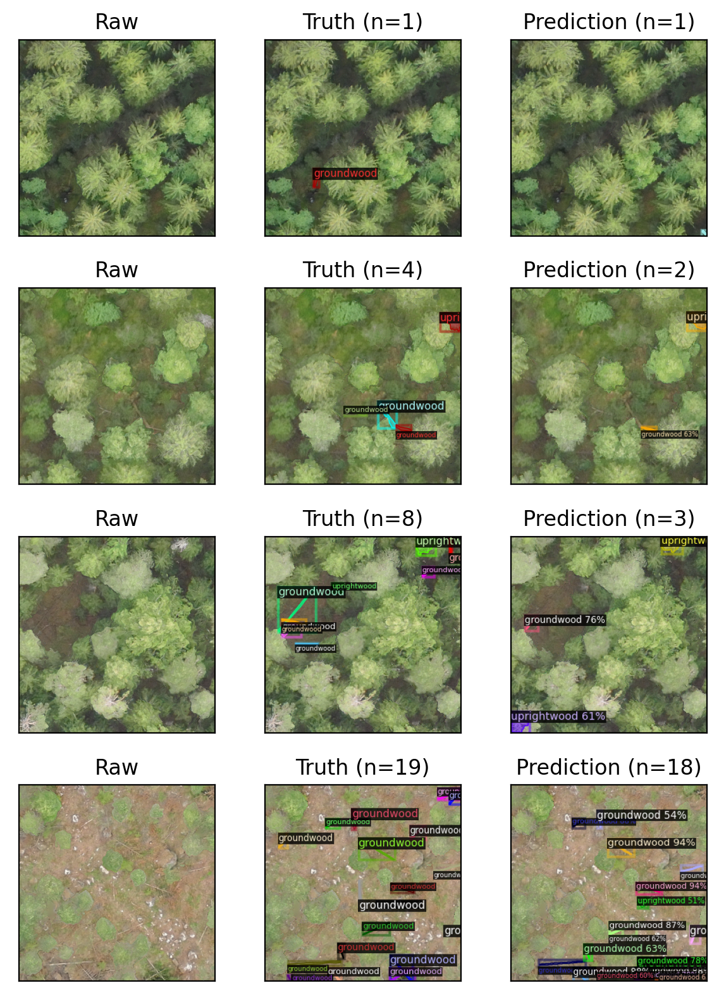

In [ ]:
#| echo: false

dataset_dicts = DatasetCatalog.get('sudenpesankangas_all')
ddicts = random.sample(dataset_dicts, 15)
fig, axs = plt.subplots(4,3, dpi=200, figsize=(6,8))
for d, i in zip(ddicts, range(0,4)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('sudenpesankangas_all'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('sudenpesankangas_all'), scale=.5)
    preds = predictor(img)
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()
plt.show()

Check the effect of TTA for Evo dataset.

In [ ]:
print(inference_on_dataset(tta_predictor.model, val_loader, evaluator))

/opt/conda/lib/python3.9/site-packages/fvcore/transforms/transform.py:434: UserWarning: The given NumPy array is not writeable, and PyTorch does not support non-writeable tensors. This means you can write to the underlying (supposedly non-writeable) NumPy array using the tensor. You may want to copy the array to protect its data or make it writeable before converting it to a tensor. This type of warning will be suppressed for the rest of this program. (Triggered internally at  ../torch/csrc/utils/tensor_numpy.cpp:189.)
  tensor = torch.from_numpy(np.ascontiguousarray(img))


Loading and preparing results...
DONE (t=0.00s)
creating index...
index created!
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.267
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=100 ] = 0.491
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=100 ] = 0.251
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.279
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.428
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=100 ] = 0.000
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=  1 ] = 0.148
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets= 10 ] = 0.312
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.321
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=100 ] = 0.295
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=100 ] = 0.525
 Average Recall     (AR) @[ IoU=0.50:0.

Results improve by 0.08, but are still clearly worse than for Hiidenportti.

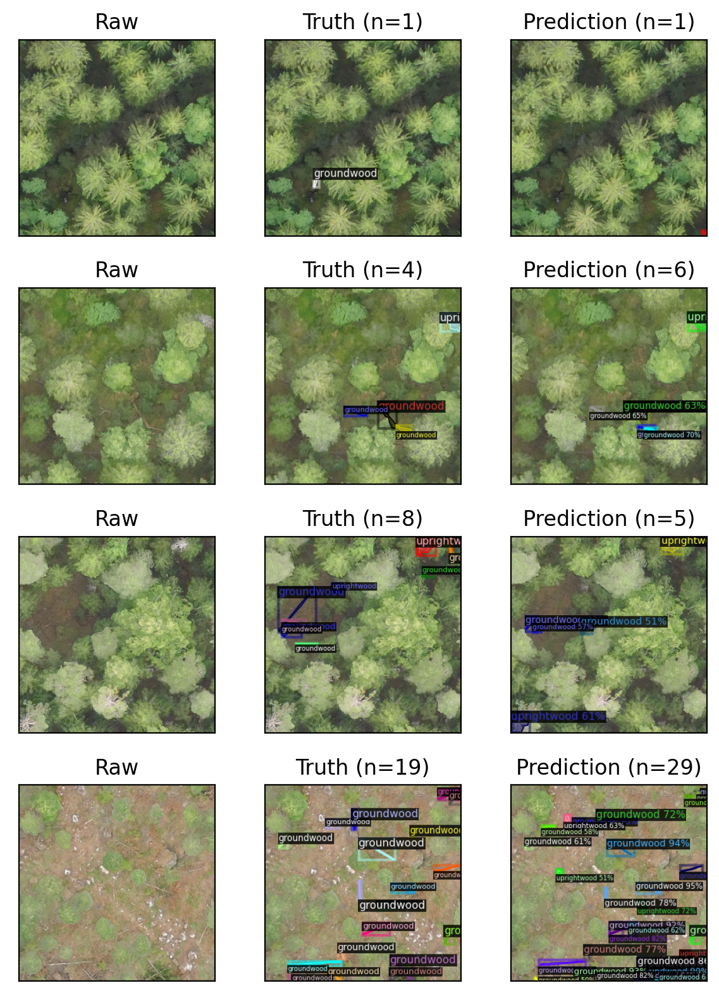

In [ ]:
#| echo: false

fig, axs = plt.subplots(4,3, dpi=200, figsize=(6,8))
for d, i in zip(ddicts, range(0,4)):
    axs[i,0].set_xticks([])
    axs[i,0].set_yticks([])
    axs[i,1].set_xticks([])
    axs[i,1].set_yticks([])
    axs[i,2].set_xticks([])
    axs[i,2].set_yticks([])
    img = cv2.imread(d["file_name"])
    axs[i,0].imshow(np.dstack((img[...,2],img[...,1], img[...,0])))
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('sudenpesankangas_all'), scale=.5)
    truth = visualizer.draw_dataset_dict(d)
    axs[i,1].imshow(truth.get_image()[...,::-1][...,::-1])
    visualizer = Visualizer(img[:, :, ::-1], metadata=MetadataCatalog.get('sudenpesankangas_all'), scale=.5)
    preds = tta_predictor(img)
    pred = visualizer.draw_instance_predictions(preds["instances"].to("cpu"))
    axs[i,2].imshow(pred.get_image()[...,::-1][...,::-1])
    axs[i,0].set_title('Raw')
    axs[i,1].set_title(f'Truth (n={len(d["annotations"])})')
    axs[i,2].set_title(f'Prediction (n={len(preds["instances"])})')
plt.tight_layout()
plt.show()